# 1.1 Setup a Folder:

---






In [2]:
import os
if not os.path.isdir("camvid_data"):
  os.makedirs("camvid_data")
%cd camvid_data

D:\Self_study\Projects\python_tutorials\projects\camvid-IS\camvid_data


## 1.2 Downloading DataSet:

---





In [5]:
import opendatasets as od
if not os.path.isdir("camvid"):
  od.download("https://www.kaggle.com/datasets/carlolepelaars/camvid")

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: Your Kaggle Key: 

  0%|          | 0.00/575M [00:00<?, ?B/s]

100%|██████████| 575M/575M [00:40<00:00, 15.0MB/s] 

## 2.1 Exploring & Visualize The Data:

---






(-0.5, 399.5, 399.5, -0.5)

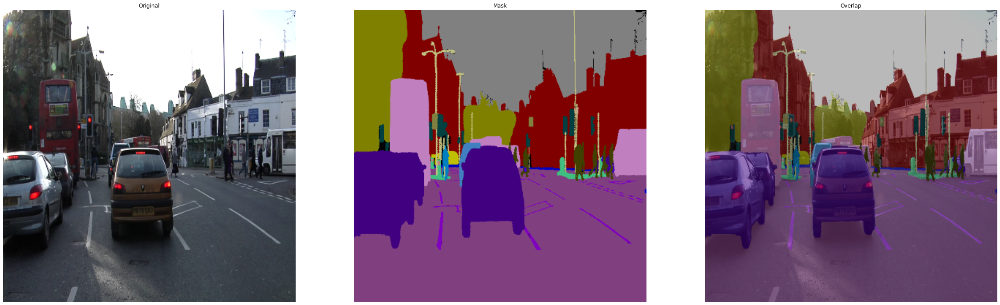

In [14]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

imagesname=[string.split(".")[0] for string in (os.listdir("camvid/CamVid/train"))]
index=np.random.randint(len(imagesname))
# index=0
Size=400

image = cv2.imread("camvid/CamVid/train/{}.png".format(imagesname[index]))
image=cv2.resize(image,(Size,Size))
image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)

mask=cv2.imread("camvid/CamVid/train_labels/{}.png".format(imagesname[index]+"_L"))
mask=cv2.resize(mask,(Size,Size))
mask=cv2.cvtColor(mask,cv2.COLOR_BGR2RGB)

#Visualizing:
plt.figure(figsize=(40,25))
plt.subplot(131)
plt.imshow(image)
plt.title("Original")
plt.axis('off')

plt.subplot(132)
plt.imshow(mask)
plt.title("Mask")
plt.axis('off')

plt.subplot(133)
plt.imshow(image)
plt.imshow(mask,alpha=.55)
plt.title("Overlap")
plt.axis('off')

In [15]:
data_path = 'camvid/CamVid'
print('Number of train frames: ' + str(len(os.listdir(data_path + '/train'))))
print('Number of train labels: ' + str(len(os.listdir(data_path + '/train_labels'))))
print('Number of val frames: ' + str(len(os.listdir(data_path + '/val'))))
print('Number of val labels: ' + str(len(os.listdir(data_path + '/val_labels'))))
print('Number of test frames: ' + str(len(os.listdir(data_path + '/test'))))
print('Number of test labels: ' + str(len(os.listdir(data_path + '/test_labels'))))

Number of train frames: 369
Number of train labels: 369
Number of val frames: 100
Number of val labels: 100
Number of test frames: 232
Number of test labels: 232


In [5]:
import pandas as pd 
classes = pd.read_csv(data_path +'/class_dict.csv', index_col =0)

In [6]:
classes

,r,g,b
name,,,
Animal,64,128,64
Archway,192,0,128
Bicyclist,0,128,192
Bridge,0,128,64
Building,128,0,0
Car,64,0,128
CartLuggagePram,64,0,192
Child,192,128,64
Column_Pole,192,192,128


In [7]:
cls2rgb = {cl:list(classes.loc[cl, :]) for cl in classes.index}
cls2rgb

In [8]:
def adjust_mask(mask):
    
    semantic_map = []
    for colour in list(cls2rgb.values()):        
        equality = np.equal(mask, colour)# 256x256x3 with True or False
        class_map = np.all(equality, axis = -1)# 256x256 If all True, then True, else False
        semantic_map.append(class_map)# List of 256x256 arrays, map of True for a given found color at the pixel, and False otherwise.
    semantic_map = np.stack(semantic_map, axis=-1)# 256x256x32 True only at the found color, and all False otherwise.
    return np.float32(semantic_map)# convert to numbers

In [9]:
idx2rgb={idx:np.array(rgb) for idx, (cl, rgb) in enumerate(cls2rgb.items())}

def map_class_to_rgb(p):
  
  return idx2rgb[p[0]]


In [ ]:
nm=adjust_mask(mask)
print(nm.shape)

(300, 300, 32)


In [ ]:
rgb_mask = np.apply_along_axis(map_class_to_rgb, -1,nm)
print(rgb_mask.shape)

(300, 300, 3)


##2.2 Data Augmentation & Loading :
---


In [11]:
from keras.preprocessing.image import ImageDataGenerator
#for training data:

train_image_datagen = ImageDataGenerator(rotation_range=10,
    width_shift_range=0.2,
    zoom_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    rescale=1./255)
train_mask_datagen = ImageDataGenerator(rotation_range=10,
    width_shift_range=0.2,
    zoom_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True)

B_size=16
seed = 2
image_generator =train_image_datagen.flow_from_directory(
    data_path,
    class_mode=None,
    classes=['train'],
    seed=seed,
    batch_size=B_size,
    target_size=(Size,Size))

mask_generator =train_mask_datagen.flow_from_directory(
    data_path,
    classes=['train_labels'],
    class_mode=None,
    seed=seed,
    color_mode='rgb',
    batch_size=B_size,
    target_size=(Size,Size))
# combine generators into one which yields image and masks
train_generator = zip(image_generator, mask_generator)

def train_generator_fn():
    for (img,mask) in train_generator:
        new_mask = adjust_mask(mask)
        yield (img,new_mask)  

Found 369 images belonging to 1 classes.
Found 369 images belonging to 1 classes.


In [13]:
#for validation data:
image_datagen = ImageDataGenerator(rescale=1./255)
mask_datagen = ImageDataGenerator()
val_image_generator = image_datagen.flow_from_directory(
    data_path,
    class_mode=None,
    classes=['val'],
    seed=seed,
    batch_size=B_size,
    target_size=(Size,Size))

val_mask_generator = mask_datagen.flow_from_directory(
    data_path,
    classes=['val_labels'],
    class_mode=None,
    seed=seed,
    batch_size=B_size,
    color_mode='rgb',
    target_size=(Size,Size))

# combine generators into one which yields image and masks
val_generator = zip(val_image_generator, val_mask_generator)

def val_generator_fn():
    for (img,mask) in val_generator:
        new_mask = adjust_mask(mask)
        yield (img,new_mask)  

Found 100 images belonging to 1 classes.
Found 100 images belonging to 1 classes.


# 3.1 Create Model:

---



In [12]:
import tensorflow as tf 
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model,load_model
from tensorflow.keras.applications import VGG19
from tensorflow.keras.utils import load_img,img_to_array,plot_model 
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint,EarlyStopping,Callback
from tensorflow.keras.layers import Conv2DTranspose,ZeroPadding2D,Conv2D,add,Dropout,Input,concatenate,Activation,MaxPooling2D,UpSampling2D,BatchNormalization,add

In [ ]:
def decoder_block(input,skip_features, num_filters,conv_padding=False,zero_pad=False):

    x=  UpSampling2D(size = (2,2))(input)

    if zero_pad == True:
      x=ZeroPadding2D((1,1))(x)
    
    if conv_padding ==True:
        x=Conv2D(num_filters, 3, activation = 'relu', padding='same', kernel_initializer = 'he_normal')(x)
    else:
        x=Conv2D(num_filters, 2, activation = 'relu', kernel_initializer = 'he_normal')(x)
   
    x=Conv2D(num_filters, 3, activation = 'relu', padding='same', kernel_initializer = 'he_normal')(x)
    x = concatenate([x, skip_features],axis=-1)
    x=BatchNormalization()(x)    
    x=Dropout(.2)(x)
    return x

In [ ]:
def Unet(input_size,n_classes):
    """ Input """
    inp = Input(input_size)
    """ Encoder """
    Basemodel= VGG19(include_top=False, weights='imagenet', input_tensor=inp)


    E0=Basemodel.get_layer("block1_conv2").output 
    E1=Basemodel.get_layer("block2_conv2").output 
    E2=Basemodel.get_layer("block3_conv4").output 
    E3=Basemodel.get_layer("block4_conv4").output
    E4=Basemodel.get_layer("block5_conv4").output    

    """bridge"""
    E5=Basemodel.get_layer("block5_pool").output
    
    """ Decoder """

    D1=decoder_block(E5,E4,512,conv_padding=True)

    D2=decoder_block(D1,E3,512,zero_pad=True)

    D3=decoder_block(D2,E2,256,zero_pad=True)    
    
    D4=decoder_block(D3,E1,64,conv_padding=True)


    D5=decoder_block(D4,E0,64,conv_padding=True)



    """ OutPut """
    Output=Conv2D(n_classes, 1, activation = 'sigmoid')(D5)
    
    model = Model(inp,Output, name="Unet")
    model.summary()
    return model

In [ ]:
model=Unet((300,300,3),32)

80134624/80134624 [==============================] - 1s 0us/step
Model: "Unet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 300, 300, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 300, 300, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv2 (Conv2D)          (None, 300, 300, 64  36928       ['block1_conv1[0][0]']           
                              

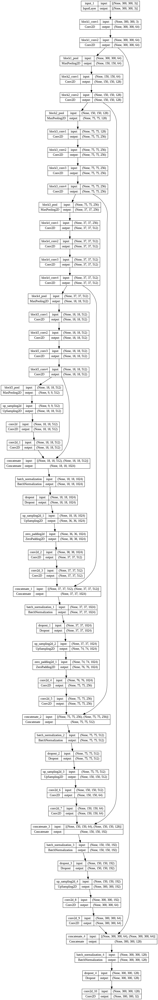

In [ ]:
plot_model(model,show_shapes=True,show_layer_names=True,expand_nested=True)

# 3.2  Callbacks & Trainning:

---


In [ ]:
model.compile(optimizer = Adam(learning_rate = 1e-4), loss='categorical_crossentropy', metrics=['accuracy'])

model_checkpoint = ModelCheckpoint('Camvid-Weights1.hdf5', monitor='val_loss',verbose=1, save_best_only=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1,patience=8, min_lr=1e-6)
Earlystop=EarlyStopping(monitor="val_loss",patience=12,mode="auto",restore_best_weights=True)

In [ ]:
class Viz_process(Callback):  
    def on_epoch_end(self, epoch, logs=None):
        # Select a random sample from the validation set
        image_batch, label_batch = next(iter(val_generator))
        idx=np.random.randint(image_batch.shape[0])
        image,label=image_batch[idx],label_batch[idx]
        label=label*1./255
        # Get predicted label
        pred_label = np.squeeze(self.model.predict(np.expand_dims(image, axis=0)),axis=0)
        pred_label=np.argmax(pred_label,axis=-1)
        rgb_mask = np.apply_along_axis(map_class_to_rgb, -1, np.expand_dims(pred_label,axis=-1))
        rgb_mask=rgb_mask*1./255
        
        ### Display the image, true label, and predicted label
        plt.figure(figsize=(18,9))
        plt.subplot(131)
        plt.imshow(image)
        plt.axis('off')
        plt.title('Original')
        plt.subplot(132)
        plt.imshow(label)
        plt.axis('off')
        plt.title('Label')   
        plt.subplot(133)
        plt.imshow(rgb_mask)
        plt.axis('off')
        plt.title('Pred_Label')
        plt.show()

Epoch 1/50
1/1 [==============================] - 0s 474ms/step


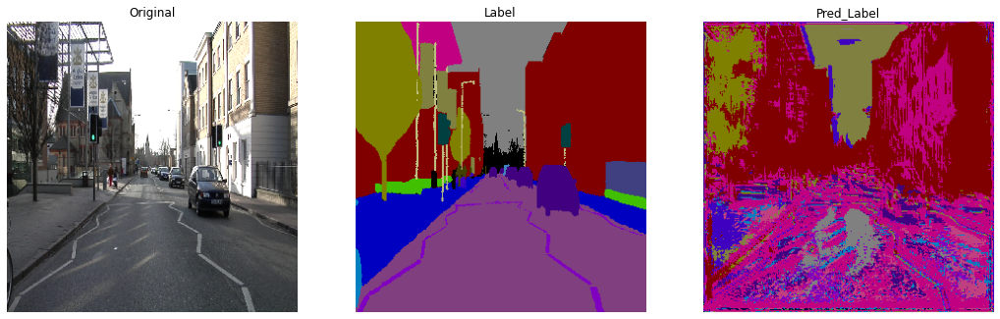


Epoch 1: val_loss improved from inf to 5.40865, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 224s 9s/step - loss: 2.5729 - accuracy: 0.3447 - val_loss: 5.4086 - val_accuracy: 0.3304 - lr: 1.0000e-04
Epoch 2/50
1/1 [==============================] - 0s 25ms/step


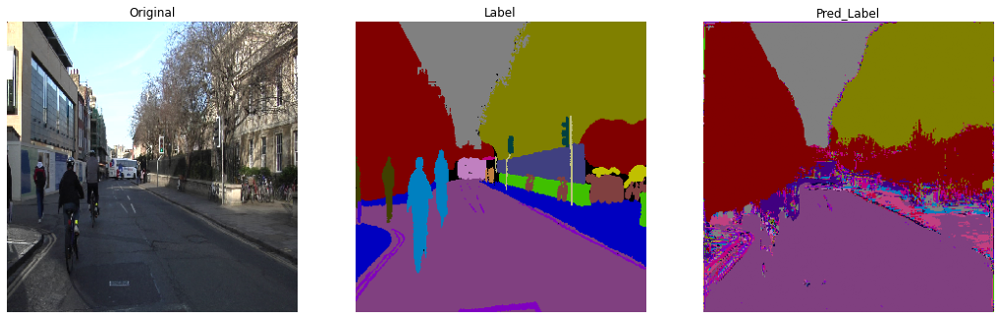


Epoch 2: val_loss improved from 5.40865 to 2.03090, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 102s 5s/step - loss: 1.3963 - accuracy: 0.6411 - val_loss: 2.0309 - val_accuracy: 0.7131 - lr: 1.0000e-04
Epoch 3/50
1/1 [==============================] - 0s 25ms/step


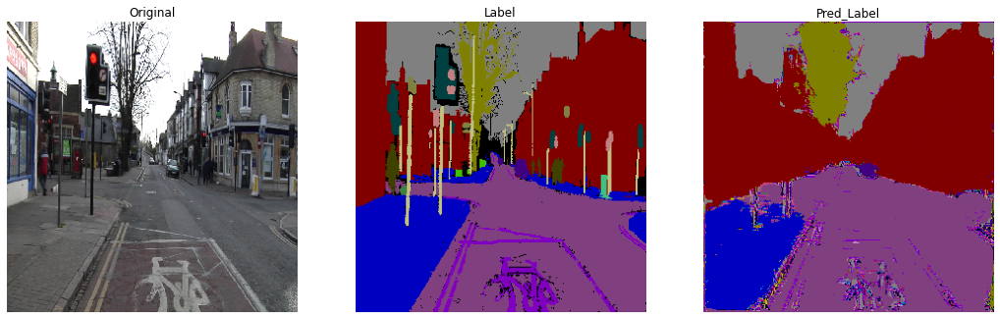


Epoch 3: val_loss improved from 2.03090 to 1.27082, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 105s 5s/step - loss: 1.0360 - accuracy: 0.7159 - val_loss: 1.2708 - val_accuracy: 0.7773 - lr: 1.0000e-04
Epoch 4/50
1/1 [==============================] - 0s 25ms/step


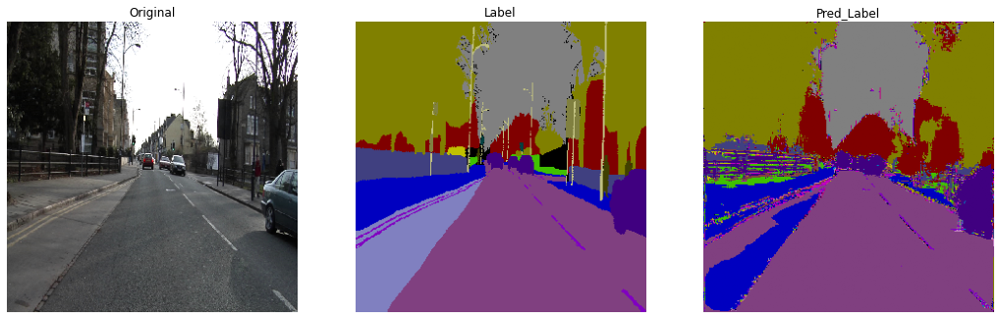


Epoch 4: val_loss improved from 1.27082 to 1.02340, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 5s/step - loss: 0.8600 - accuracy: 0.7476 - val_loss: 1.0234 - val_accuracy: 0.8037 - lr: 1.0000e-04
Epoch 5/50
1/1 [==============================] - 0s 39ms/step


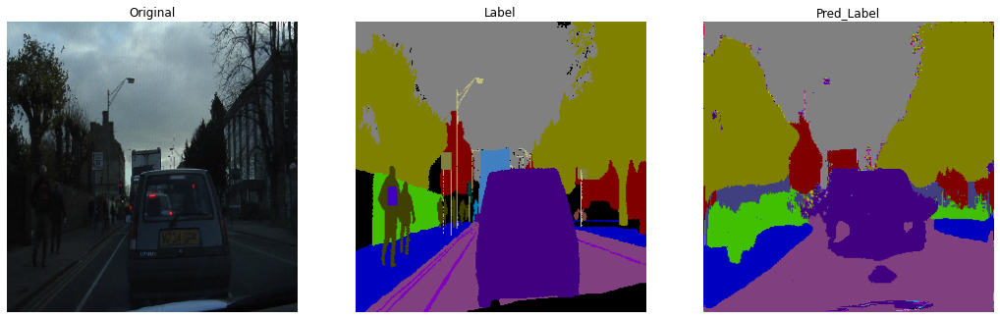


Epoch 5: val_loss improved from 1.02340 to 0.86008, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 5s/step - loss: 0.7791 - accuracy: 0.7627 - val_loss: 0.8601 - val_accuracy: 0.8256 - lr: 1.0000e-04
Epoch 6/50
1/1 [==============================] - 0s 26ms/step


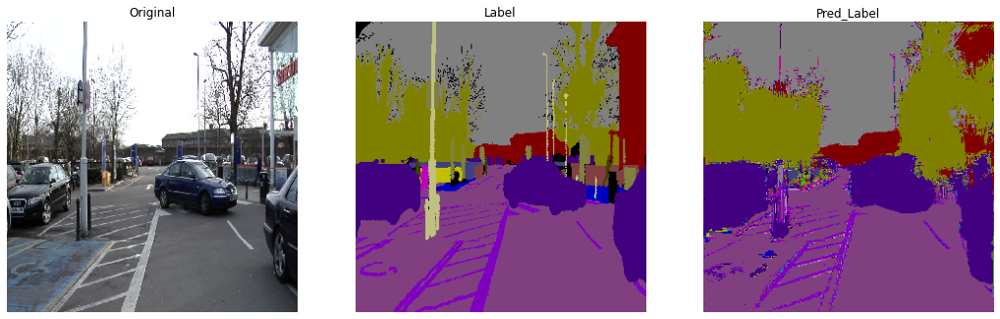


Epoch 6: val_loss did not improve from 0.86008
23/23 [==============================] - 101s 4s/step - loss: 0.7320 - accuracy: 0.7716 - val_loss: 0.8795 - val_accuracy: 0.8142 - lr: 1.0000e-04
Epoch 7/50
1/1 [==============================] - 0s 30ms/step


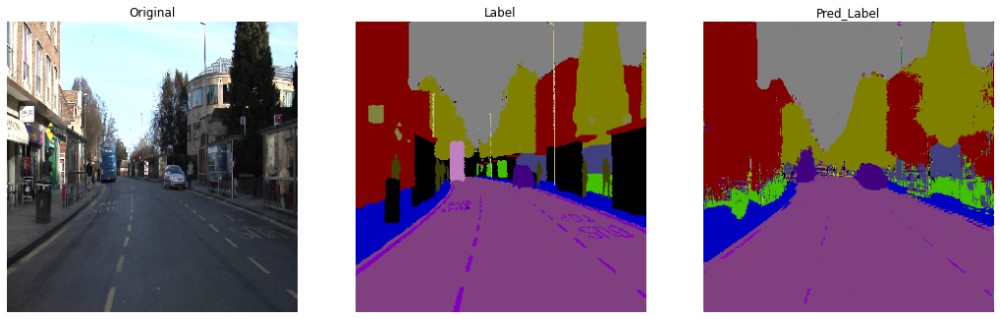


Epoch 7: val_loss improved from 0.86008 to 0.79252, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 100s 4s/step - loss: 0.6949 - accuracy: 0.7739 - val_loss: 0.7925 - val_accuracy: 0.8315 - lr: 1.0000e-04
Epoch 8/50
1/1 [==============================] - 0s 25ms/step


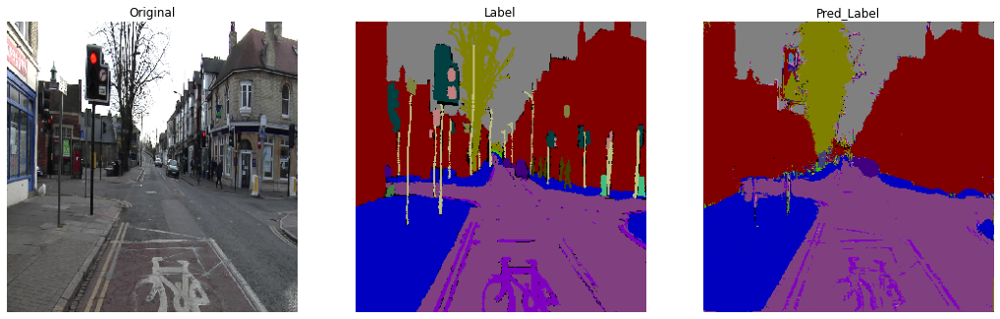


Epoch 8: val_loss improved from 0.79252 to 0.73303, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 104s 5s/step - loss: 0.6311 - accuracy: 0.7915 - val_loss: 0.7330 - val_accuracy: 0.8398 - lr: 1.0000e-04
Epoch 9/50
1/1 [==============================] - 0s 27ms/step


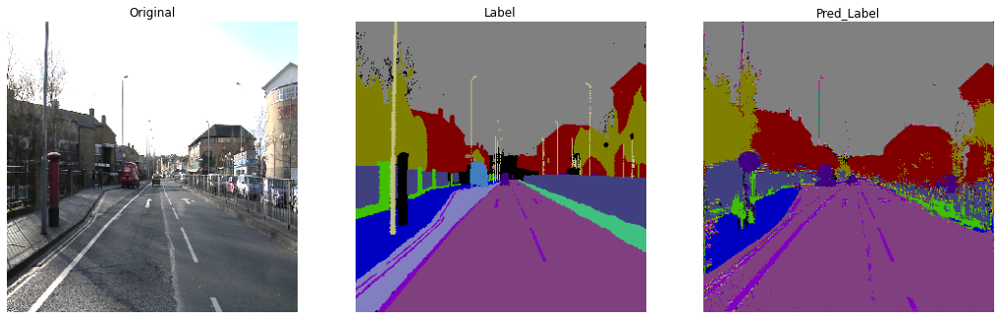


Epoch 9: val_loss improved from 0.73303 to 0.71524, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 5s/step - loss: 0.6239 - accuracy: 0.7906 - val_loss: 0.7152 - val_accuracy: 0.8392 - lr: 1.0000e-04
Epoch 10/50
1/1 [==============================] - 0s 28ms/step


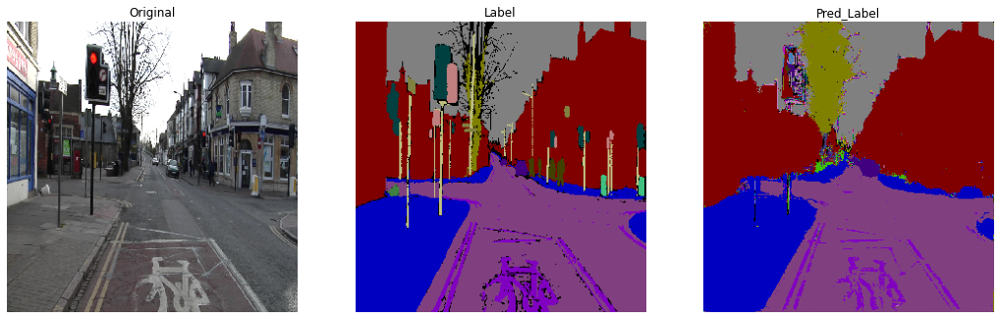


Epoch 10: val_loss improved from 0.71524 to 0.67991, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 104s 5s/step - loss: 0.6106 - accuracy: 0.7916 - val_loss: 0.6799 - val_accuracy: 0.8476 - lr: 1.0000e-04
Epoch 11/50
1/1 [==============================] - 0s 35ms/step


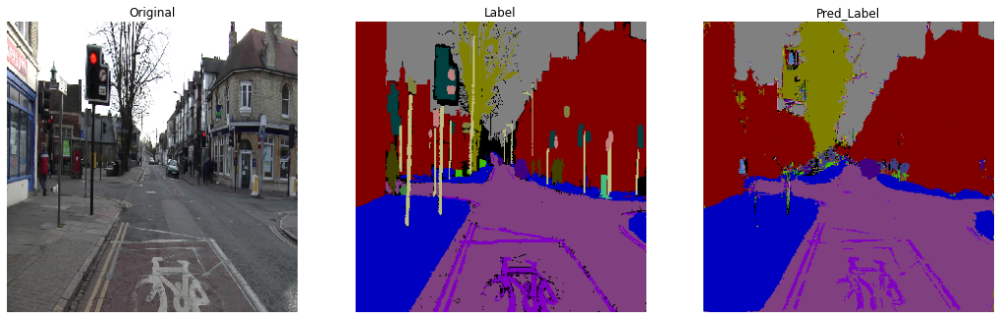


Epoch 11: val_loss did not improve from 0.67991
23/23 [==============================] - 101s 5s/step - loss: 0.5785 - accuracy: 0.8001 - val_loss: 0.7220 - val_accuracy: 0.8347 - lr: 1.0000e-04
Epoch 12/50
1/1 [==============================] - 0s 36ms/step


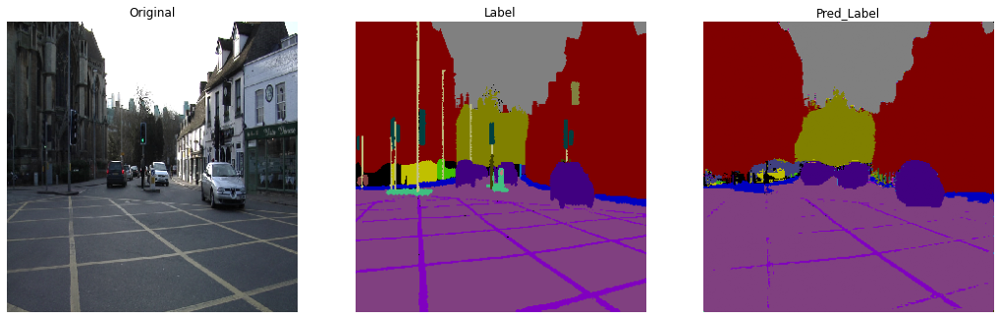


Epoch 12: val_loss did not improve from 0.67991
23/23 [==============================] - 95s 4s/step - loss: 0.5638 - accuracy: 0.8014 - val_loss: 0.6822 - val_accuracy: 0.8424 - lr: 1.0000e-04
Epoch 13/50
1/1 [==============================] - 0s 39ms/step


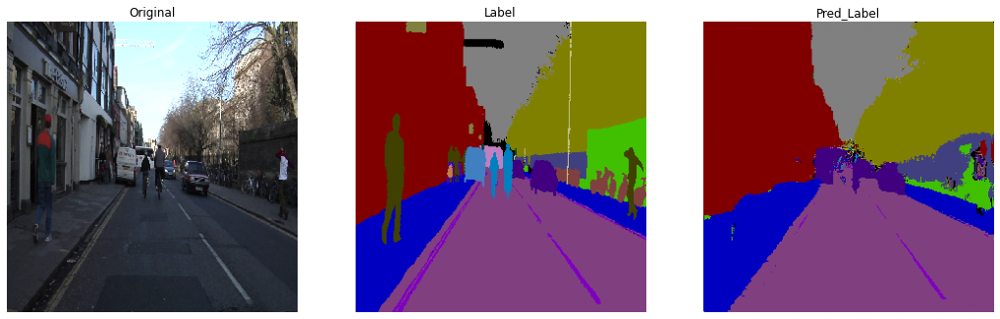


Epoch 13: val_loss improved from 0.67991 to 0.63929, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 4s/step - loss: 0.5232 - accuracy: 0.8081 - val_loss: 0.6393 - val_accuracy: 0.8515 - lr: 1.0000e-04
Epoch 14/50
1/1 [==============================] - 0s 26ms/step


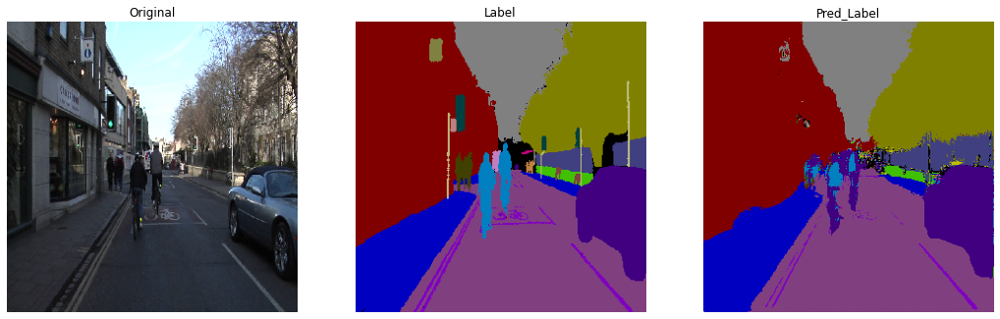


Epoch 14: val_loss did not improve from 0.63929
23/23 [==============================] - 99s 4s/step - loss: 0.5066 - accuracy: 0.8160 - val_loss: 0.6517 - val_accuracy: 0.8489 - lr: 1.0000e-04
Epoch 15/50
1/1 [==============================] - 0s 27ms/step


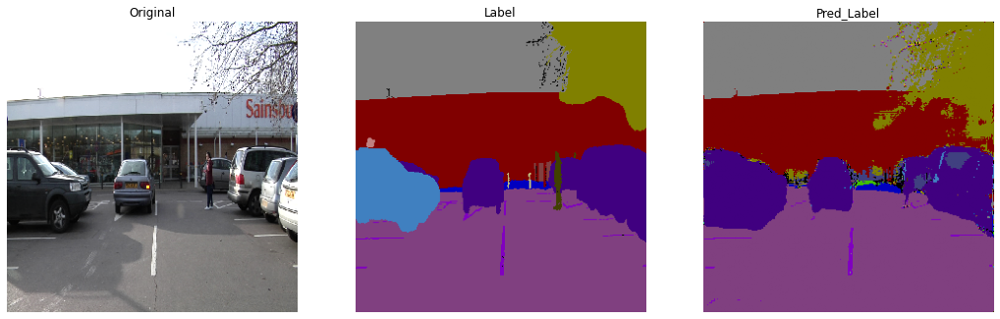


Epoch 15: val_loss did not improve from 0.63929
23/23 [==============================] - 96s 4s/step - loss: 0.6569 - accuracy: 0.7821 - val_loss: 0.7124 - val_accuracy: 0.8272 - lr: 1.0000e-04
Epoch 16/50
1/1 [==============================] - 0s 25ms/step


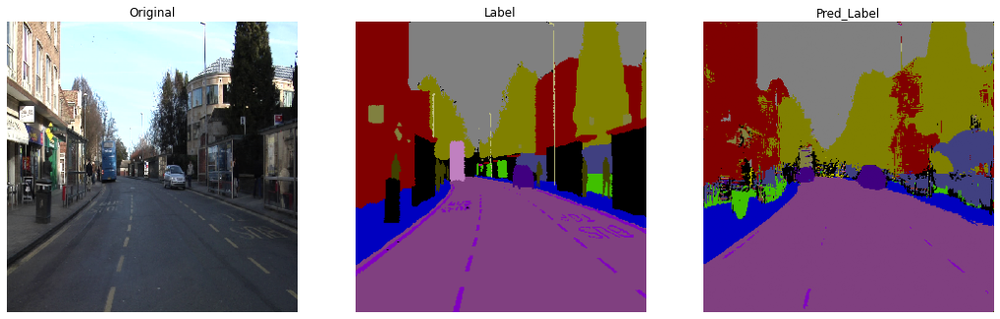


Epoch 16: val_loss did not improve from 0.63929
23/23 [==============================] - 100s 4s/step - loss: 0.5278 - accuracy: 0.8069 - val_loss: 0.6764 - val_accuracy: 0.8372 - lr: 1.0000e-04
Epoch 17/50
1/1 [==============================] - 0s 28ms/step


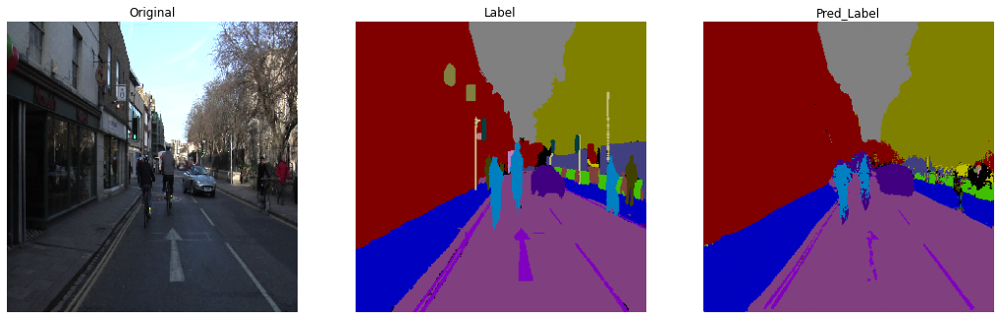


Epoch 17: val_loss improved from 0.63929 to 0.63920, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 100s 4s/step - loss: 0.5692 - accuracy: 0.7998 - val_loss: 0.6392 - val_accuracy: 0.8503 - lr: 1.0000e-04
Epoch 18/50
1/1 [==============================] - 0s 26ms/step


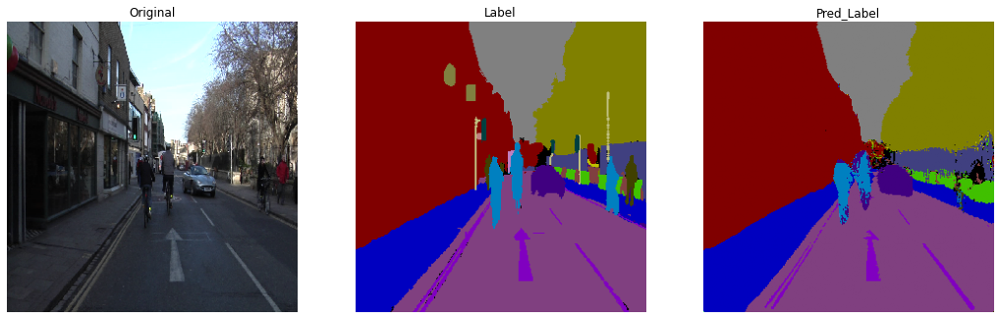


Epoch 18: val_loss did not improve from 0.63920
23/23 [==============================] - 100s 4s/step - loss: 0.4942 - accuracy: 0.8162 - val_loss: 0.6420 - val_accuracy: 0.8514 - lr: 1.0000e-04
Epoch 19/50
1/1 [==============================] - 0s 24ms/step


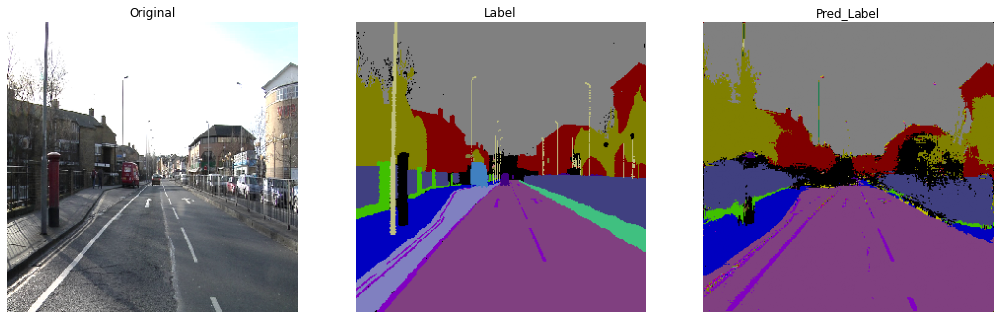


Epoch 19: val_loss did not improve from 0.63920
23/23 [==============================] - 96s 4s/step - loss: 0.4696 - accuracy: 0.8211 - val_loss: 0.6963 - val_accuracy: 0.8324 - lr: 1.0000e-04
Epoch 20/50
1/1 [==============================] - 0s 32ms/step


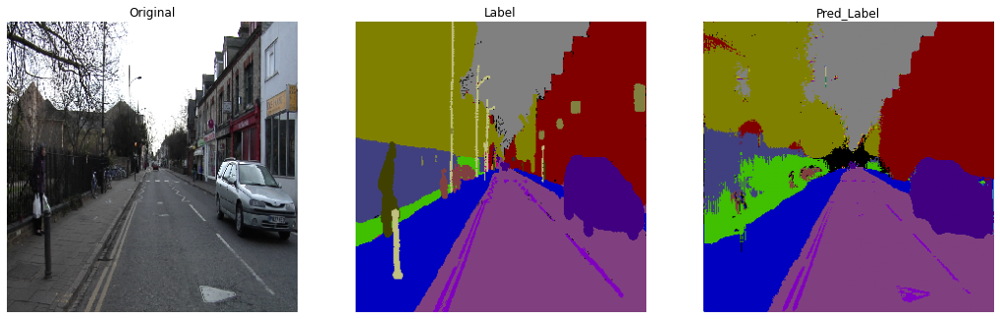


Epoch 20: val_loss improved from 0.63920 to 0.62439, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 4s/step - loss: 0.5596 - accuracy: 0.8091 - val_loss: 0.6244 - val_accuracy: 0.8531 - lr: 1.0000e-04
Epoch 21/50
1/1 [==============================] - 0s 28ms/step


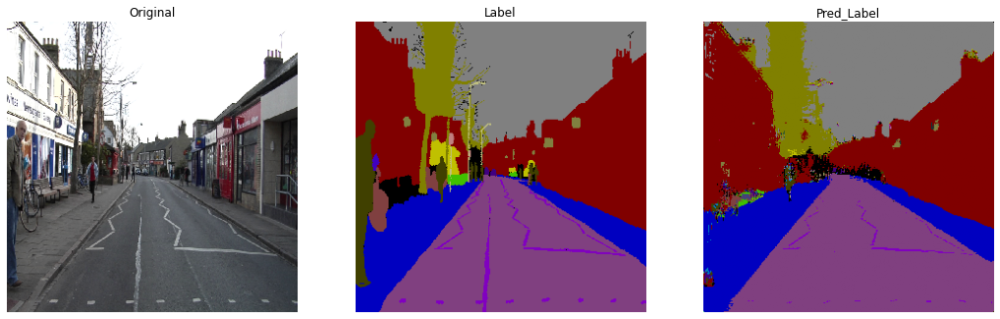


Epoch 21: val_loss improved from 0.62439 to 0.57978, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 100s 4s/step - loss: 0.5271 - accuracy: 0.8155 - val_loss: 0.5798 - val_accuracy: 0.8644 - lr: 1.0000e-04
Epoch 22/50
1/1 [==============================] - 0s 28ms/step


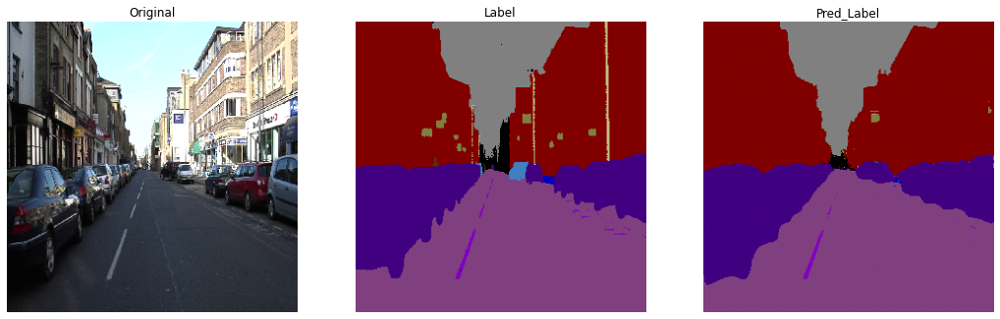


Epoch 22: val_loss improved from 0.57978 to 0.57229, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 106s 5s/step - loss: 0.4575 - accuracy: 0.8261 - val_loss: 0.5723 - val_accuracy: 0.8673 - lr: 1.0000e-04
Epoch 23/50
1/1 [==============================] - 0s 30ms/step


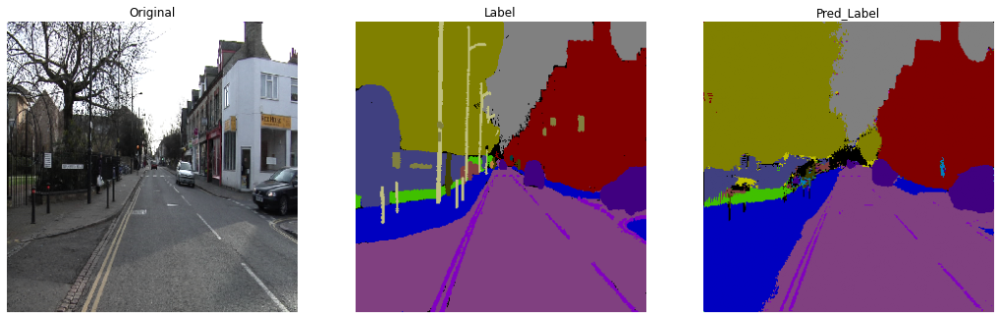


Epoch 23: val_loss did not improve from 0.57229
23/23 [==============================] - 97s 4s/step - loss: 0.4452 - accuracy: 0.8261 - val_loss: 0.5800 - val_accuracy: 0.8610 - lr: 1.0000e-04
Epoch 24/50
1/1 [==============================] - 0s 30ms/step


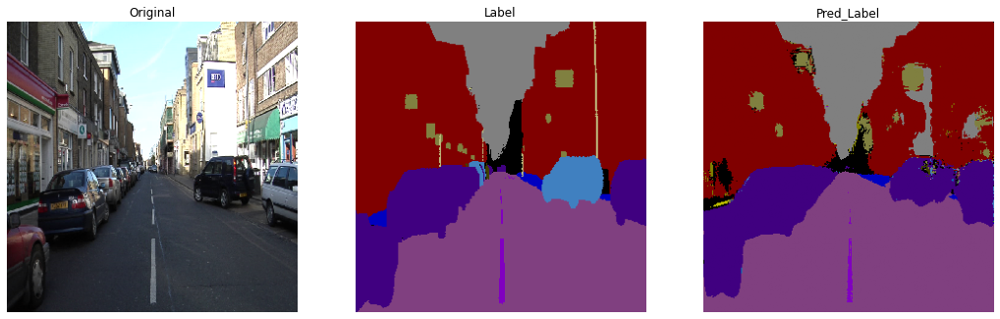


Epoch 24: val_loss improved from 0.57229 to 0.55964, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 100s 4s/step - loss: 0.4330 - accuracy: 0.8297 - val_loss: 0.5596 - val_accuracy: 0.8633 - lr: 1.0000e-04
Epoch 25/50
1/1 [==============================] - 0s 26ms/step


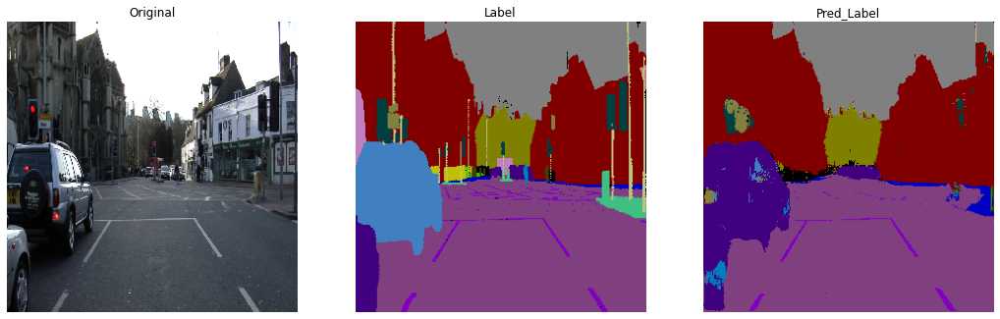


Epoch 25: val_loss improved from 0.55964 to 0.53076, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 105s 5s/step - loss: 0.4184 - accuracy: 0.8342 - val_loss: 0.5308 - val_accuracy: 0.8748 - lr: 1.0000e-04
Epoch 26/50
1/1 [==============================] - 0s 41ms/step


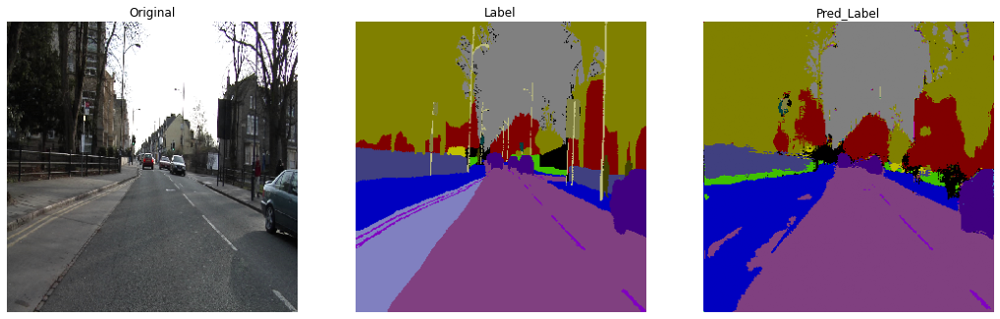


Epoch 26: val_loss did not improve from 0.53076
23/23 [==============================] - 98s 4s/step - loss: 0.5242 - accuracy: 0.8154 - val_loss: 0.5465 - val_accuracy: 0.8715 - lr: 1.0000e-04
Epoch 27/50
1/1 [==============================] - 0s 37ms/step


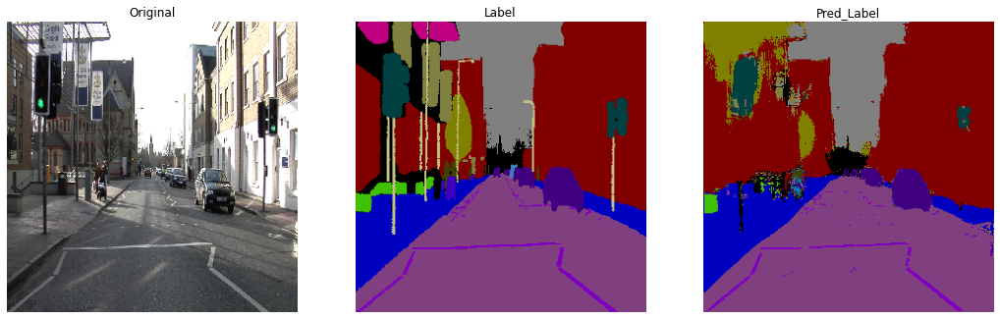


Epoch 27: val_loss did not improve from 0.53076
23/23 [==============================] - 98s 4s/step - loss: 0.4297 - accuracy: 0.8307 - val_loss: 0.5312 - val_accuracy: 0.8731 - lr: 1.0000e-04
Epoch 28/50
1/1 [==============================] - 0s 24ms/step


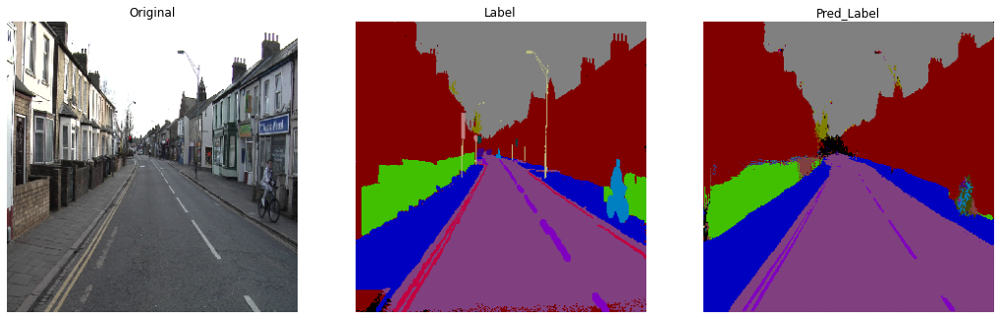


Epoch 28: val_loss did not improve from 0.53076
23/23 [==============================] - 98s 4s/step - loss: 0.4082 - accuracy: 0.8338 - val_loss: 0.5678 - val_accuracy: 0.8630 - lr: 1.0000e-04
Epoch 29/50
1/1 [==============================] - 0s 23ms/step


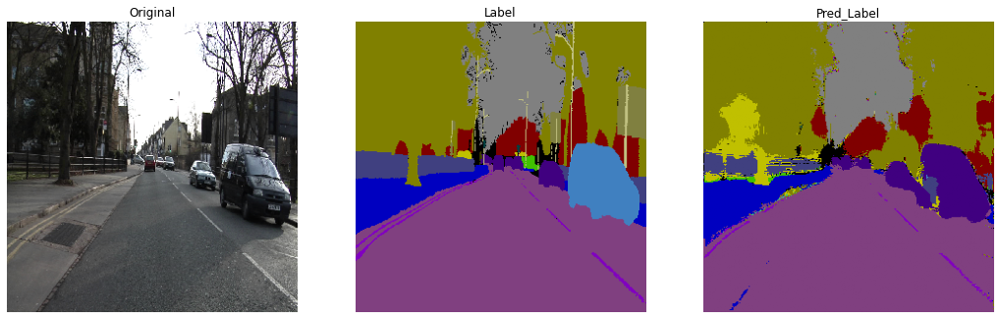


Epoch 29: val_loss did not improve from 0.53076
23/23 [==============================] - 99s 4s/step - loss: 0.4170 - accuracy: 0.8326 - val_loss: 0.5418 - val_accuracy: 0.8689 - lr: 1.0000e-04
Epoch 30/50
1/1 [==============================] - 0s 27ms/step


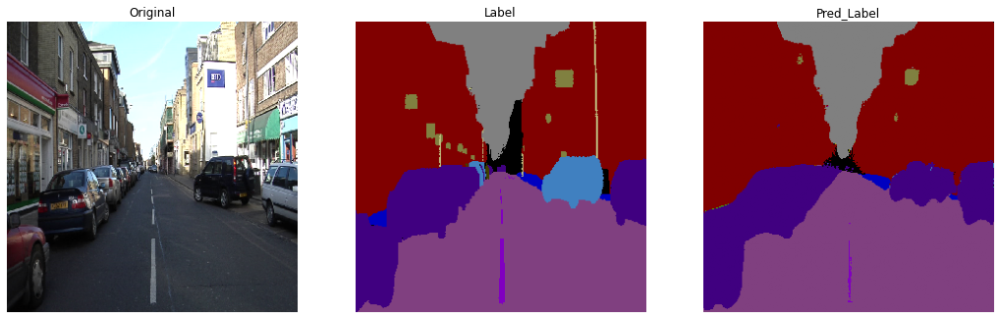


Epoch 30: val_loss did not improve from 0.53076
23/23 [==============================] - 100s 4s/step - loss: 0.4327 - accuracy: 0.8293 - val_loss: 0.5333 - val_accuracy: 0.8734 - lr: 1.0000e-04
Epoch 31/50
1/1 [==============================] - 0s 35ms/step


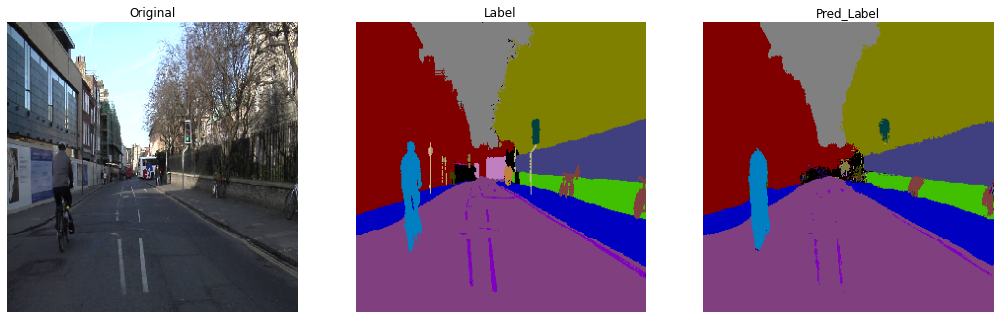


Epoch 31: val_loss improved from 0.53076 to 0.51161, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 105s 5s/step - loss: 0.4170 - accuracy: 0.8323 - val_loss: 0.5116 - val_accuracy: 0.8780 - lr: 1.0000e-04
Epoch 32/50
1/1 [==============================] - 0s 25ms/step


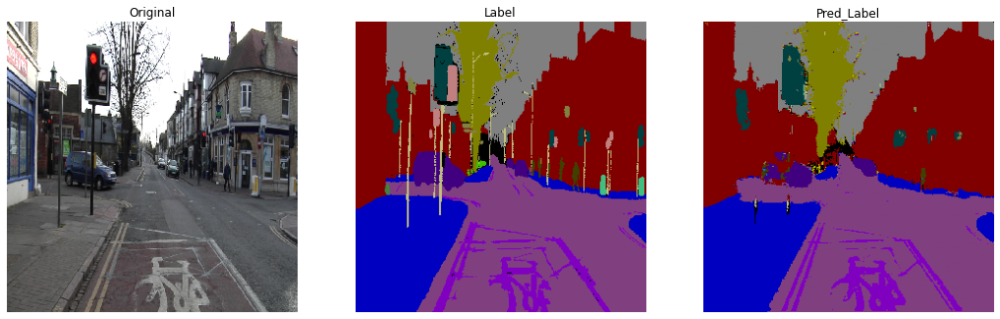


Epoch 32: val_loss improved from 0.51161 to 0.49638, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 103s 5s/step - loss: 0.3915 - accuracy: 0.8374 - val_loss: 0.4964 - val_accuracy: 0.8819 - lr: 1.0000e-04
Epoch 33/50
1/1 [==============================] - 0s 28ms/step


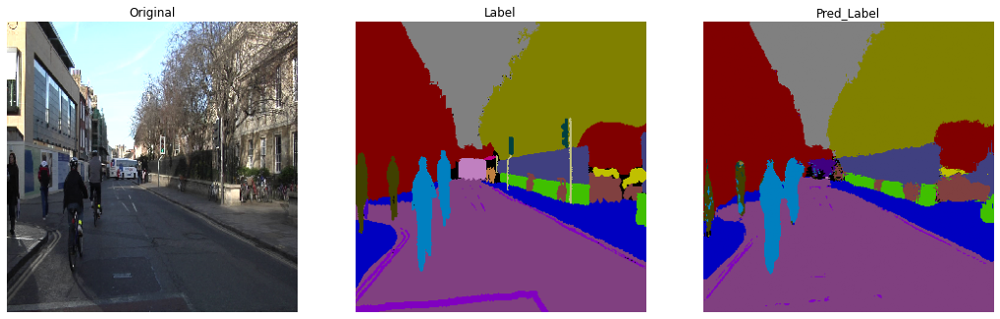


Epoch 33: val_loss did not improve from 0.49638
23/23 [==============================] - 102s 5s/step - loss: 0.4017 - accuracy: 0.8330 - val_loss: 0.5022 - val_accuracy: 0.8817 - lr: 1.0000e-04
Epoch 34/50
1/1 [==============================] - 0s 38ms/step


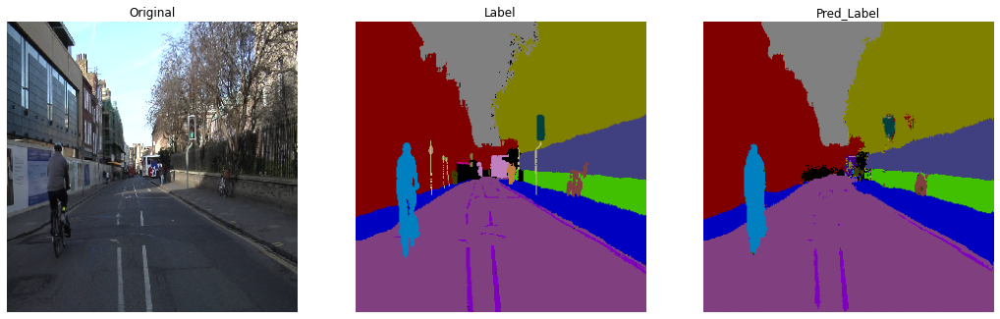


Epoch 34: val_loss did not improve from 0.49638
23/23 [==============================] - 99s 4s/step - loss: 0.3825 - accuracy: 0.8401 - val_loss: 0.5258 - val_accuracy: 0.8756 - lr: 1.0000e-04
Epoch 35/50
1/1 [==============================] - 0s 26ms/step


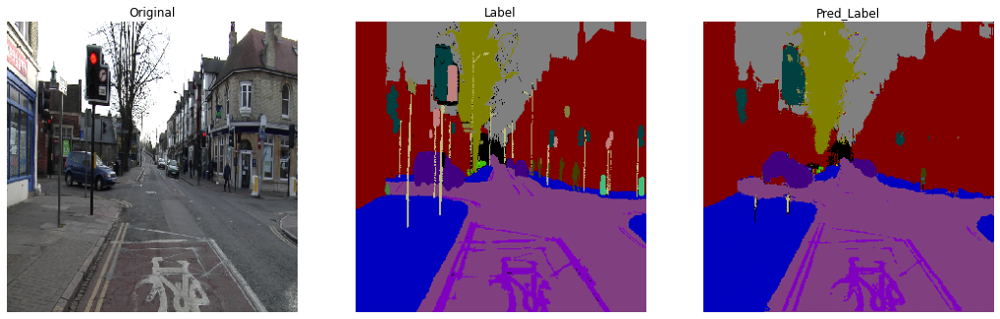


Epoch 35: val_loss did not improve from 0.49638
23/23 [==============================] - 97s 4s/step - loss: 0.4325 - accuracy: 0.8355 - val_loss: 0.5249 - val_accuracy: 0.8736 - lr: 1.0000e-04
Epoch 36/50
1/1 [==============================] - 0s 28ms/step


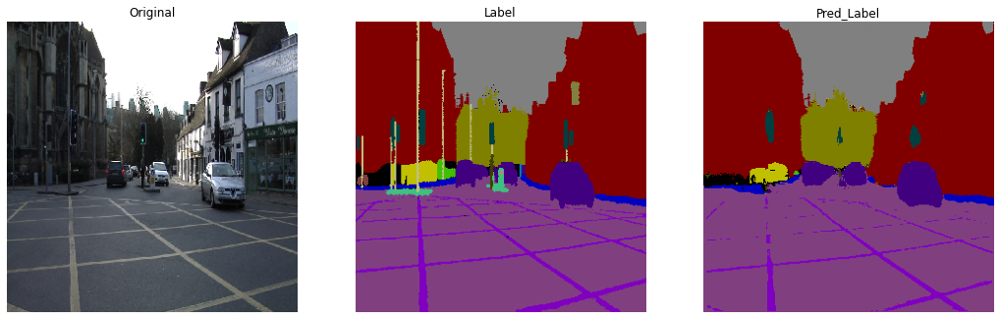


Epoch 36: val_loss did not improve from 0.49638
23/23 [==============================] - 100s 4s/step - loss: 0.3713 - accuracy: 0.8435 - val_loss: 0.4978 - val_accuracy: 0.8817 - lr: 1.0000e-04
Epoch 37/50
1/1 [==============================] - 0s 25ms/step


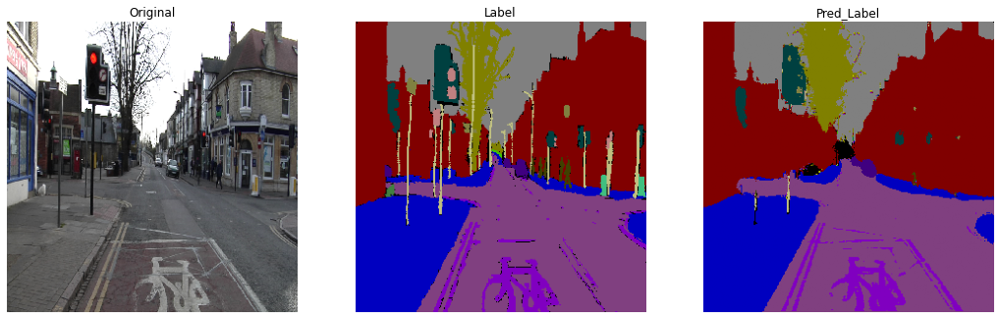


Epoch 37: val_loss did not improve from 0.49638
23/23 [==============================] - 96s 4s/step - loss: 0.3939 - accuracy: 0.8415 - val_loss: 0.5095 - val_accuracy: 0.8788 - lr: 1.0000e-04
Epoch 38/50
1/1 [==============================] - 0s 38ms/step


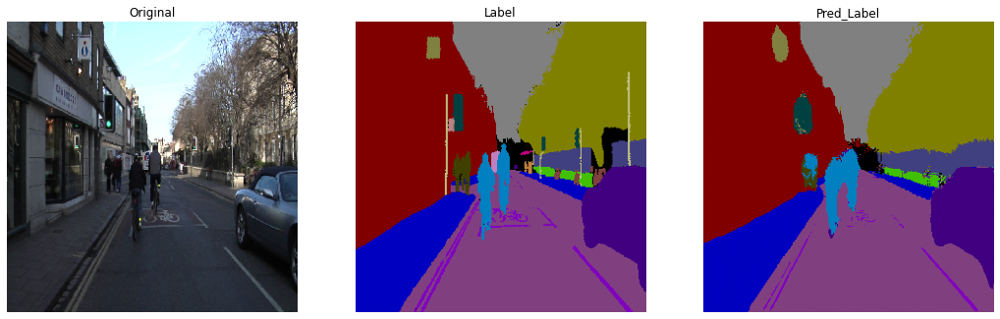


Epoch 38: val_loss did not improve from 0.49638
23/23 [==============================] - 101s 5s/step - loss: 0.3659 - accuracy: 0.8445 - val_loss: 0.5061 - val_accuracy: 0.8775 - lr: 1.0000e-04
Epoch 39/50
1/1 [==============================] - 0s 47ms/step


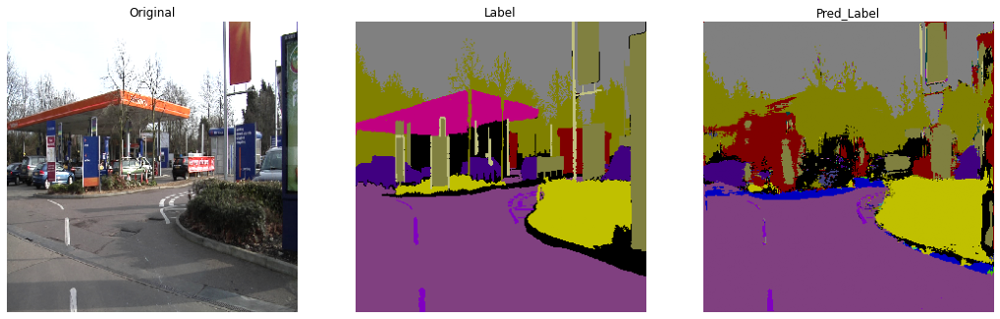


Epoch 39: val_loss did not improve from 0.49638
23/23 [==============================] - 96s 4s/step - loss: 0.3754 - accuracy: 0.8399 - val_loss: 0.5203 - val_accuracy: 0.8748 - lr: 1.0000e-04
Epoch 40/50
1/1 [==============================] - 0s 25ms/step


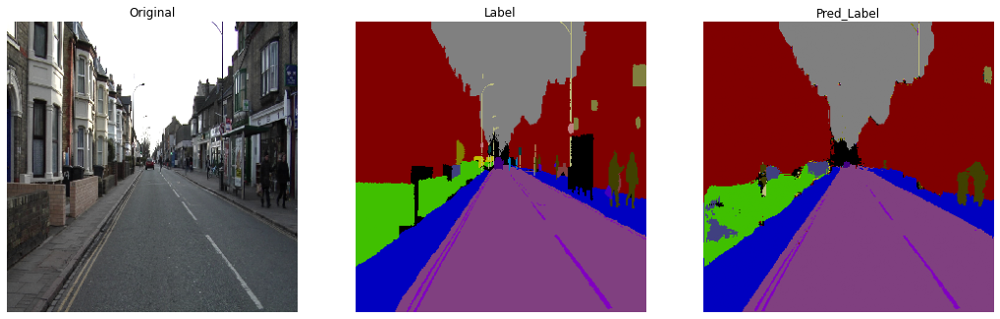


Epoch 40: val_loss did not improve from 0.49638
23/23 [==============================] - 95s 4s/step - loss: 0.3443 - accuracy: 0.8480 - val_loss: 0.5060 - val_accuracy: 0.8790 - lr: 1.0000e-04
Epoch 41/50
1/1 [==============================] - 0s 27ms/step


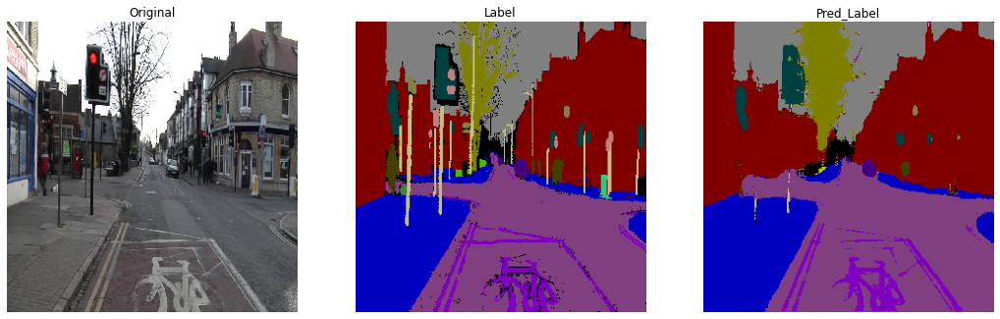


Epoch 41: val_loss improved from 0.49638 to 0.45852, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 4s/step - loss: 0.3600 - accuracy: 0.8463 - val_loss: 0.4585 - val_accuracy: 0.8903 - lr: 1.0000e-05
Epoch 42/50
1/1 [==============================] - 0s 40ms/step


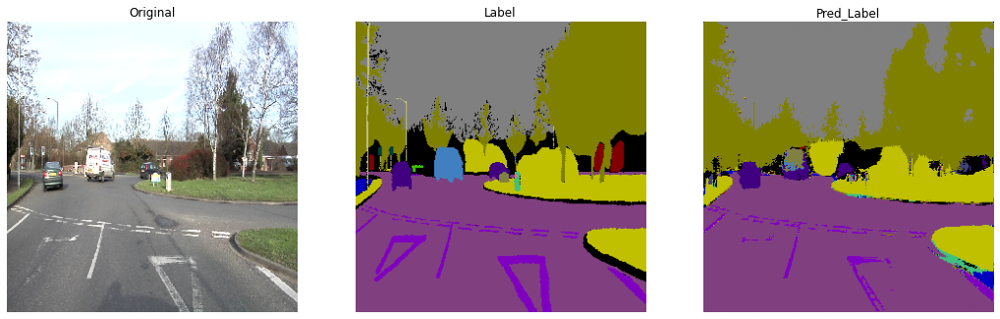


Epoch 42: val_loss did not improve from 0.45852
23/23 [==============================] - 98s 4s/step - loss: 0.3315 - accuracy: 0.8546 - val_loss: 0.4653 - val_accuracy: 0.8894 - lr: 1.0000e-05
Epoch 43/50
1/1 [==============================] - 0s 24ms/step


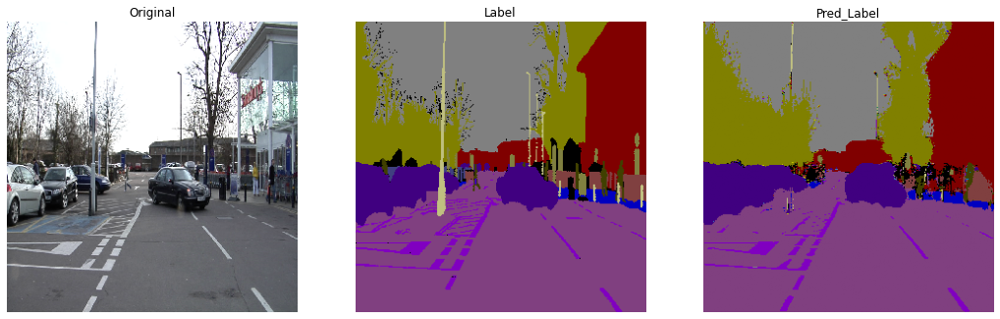


Epoch 43: val_loss did not improve from 0.45852
23/23 [==============================] - 97s 4s/step - loss: 0.3419 - accuracy: 0.8488 - val_loss: 0.4742 - val_accuracy: 0.8879 - lr: 1.0000e-05
Epoch 44/50
1/1 [==============================] - 0s 42ms/step


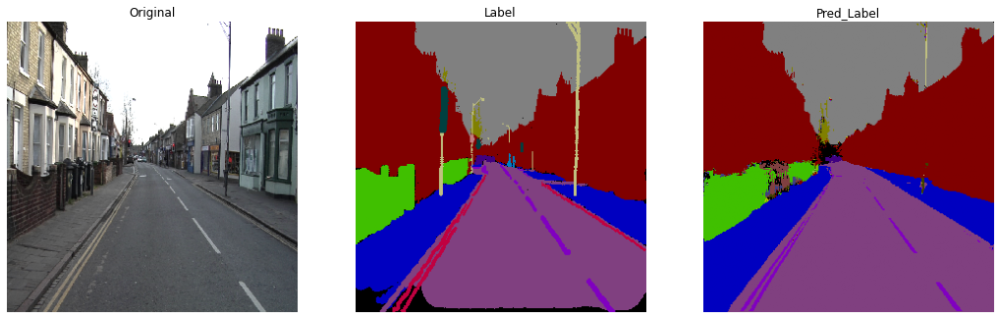


Epoch 44: val_loss did not improve from 0.45852
23/23 [==============================] - 97s 4s/step - loss: 0.3246 - accuracy: 0.8562 - val_loss: 0.4721 - val_accuracy: 0.8897 - lr: 1.0000e-05
Epoch 45/50
1/1 [==============================] - 0s 27ms/step


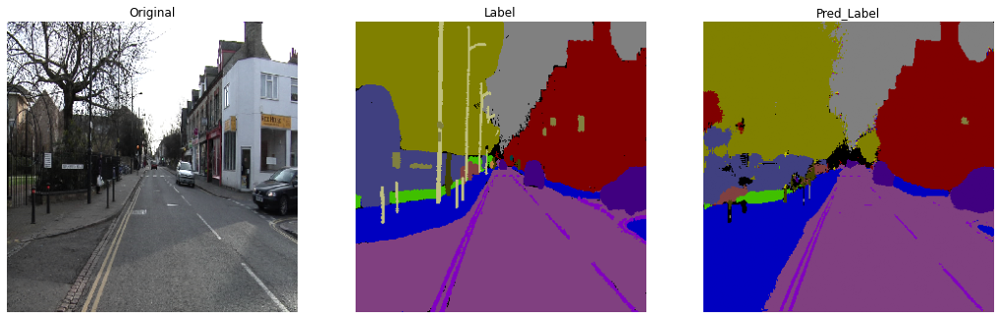


Epoch 45: val_loss improved from 0.45852 to 0.45405, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 5s/step - loss: 0.3192 - accuracy: 0.8555 - val_loss: 0.4541 - val_accuracy: 0.8928 - lr: 1.0000e-05
Epoch 46/50
1/1 [==============================] - 0s 32ms/step


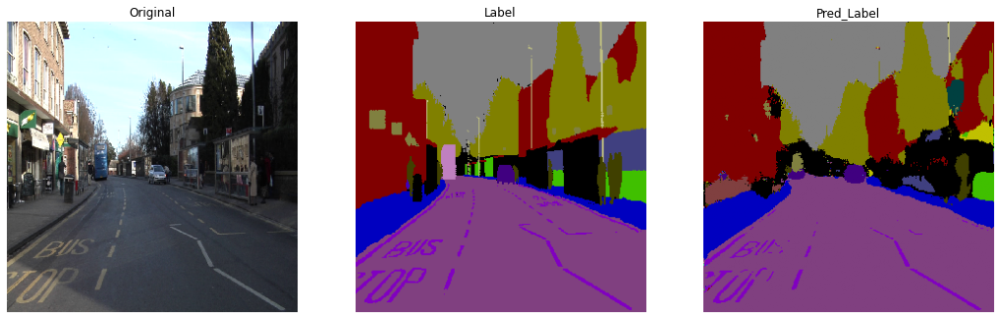


Epoch 46: val_loss did not improve from 0.45405
23/23 [==============================] - 102s 5s/step - loss: 0.3301 - accuracy: 0.8531 - val_loss: 0.4749 - val_accuracy: 0.8884 - lr: 1.0000e-05
Epoch 47/50
1/1 [==============================] - 0s 24ms/step


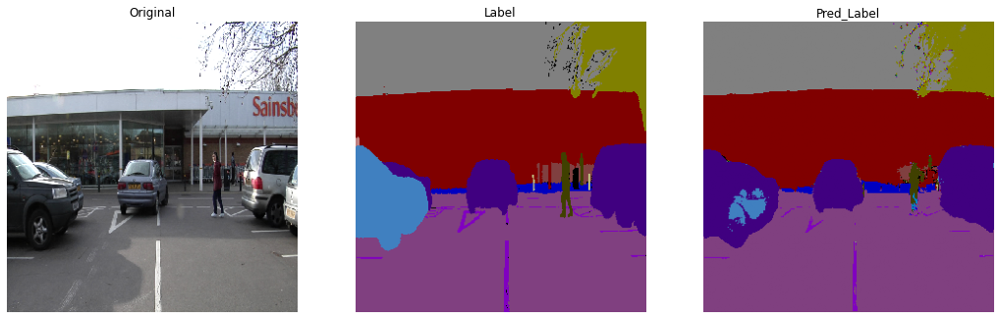


Epoch 47: val_loss improved from 0.45405 to 0.45127, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 101s 5s/step - loss: 0.3104 - accuracy: 0.8580 - val_loss: 0.4513 - val_accuracy: 0.8950 - lr: 1.0000e-05
Epoch 48/50
1/1 [==============================] - 0s 29ms/step


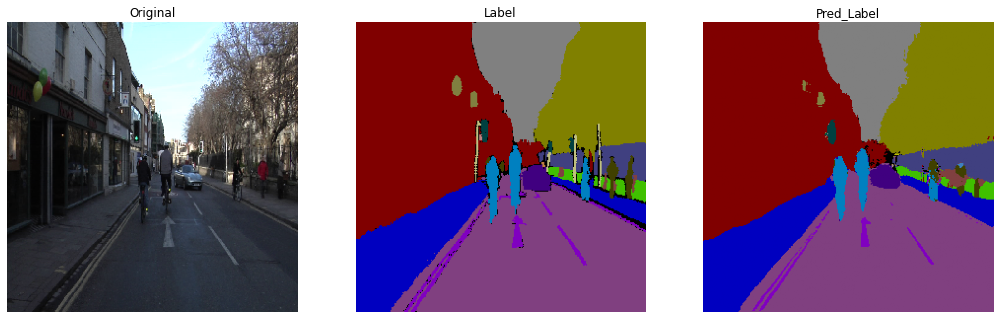


Epoch 48: val_loss did not improve from 0.45127
23/23 [==============================] - 101s 5s/step - loss: 0.3227 - accuracy: 0.8559 - val_loss: 0.4614 - val_accuracy: 0.8921 - lr: 1.0000e-05
Epoch 49/50
1/1 [==============================] - 0s 25ms/step


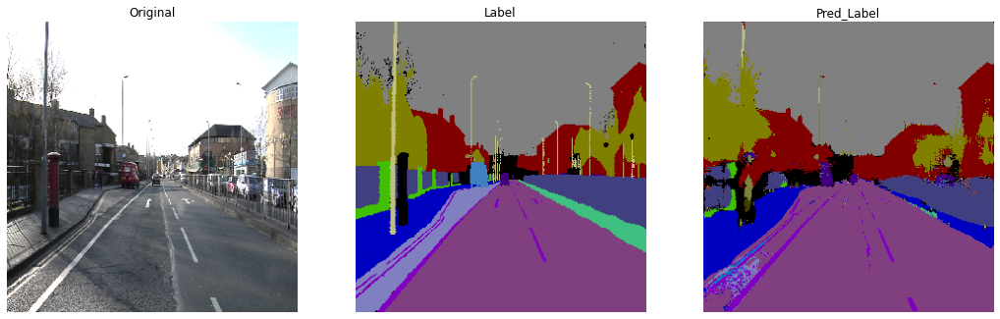


Epoch 49: val_loss did not improve from 0.45127
23/23 [==============================] - 94s 4s/step - loss: 0.3235 - accuracy: 0.8561 - val_loss: 0.4526 - val_accuracy: 0.8939 - lr: 1.0000e-05
Epoch 50/50
1/1 [==============================] - 0s 30ms/step


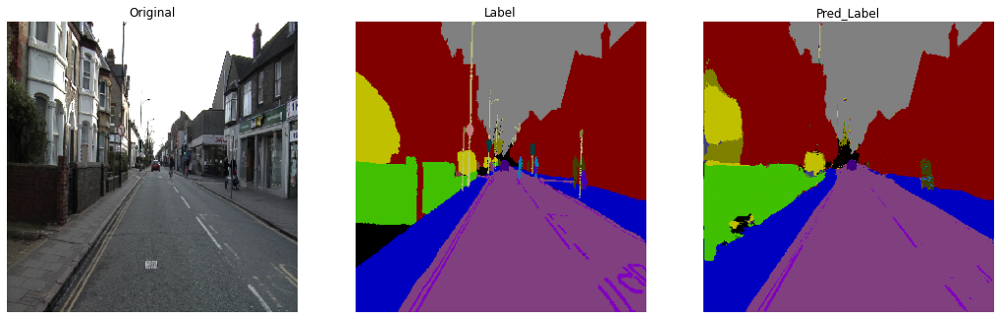


Epoch 50: val_loss did not improve from 0.45127
23/23 [==============================] - 101s 5s/step - loss: 0.4726 - accuracy: 0.8350 - val_loss: 0.4745 - val_accuracy: 0.8899 - lr: 1.0000e-05


In [ ]:
epochs=50
steps=int(369/B_size)
valid_steps=int(100/B_size)

Hisotry=model.fit(train_generator_fn(),
        validation_data=val_generator_fn(),
        steps_per_epoch=steps,
        validation_steps=valid_steps,
        epochs=epochs,
        callbacks=[Viz_process(),model_checkpoint,reduce_lr,Earlystop])

Epoch 1/20
1/1 [==============================] - 0s 25ms/step


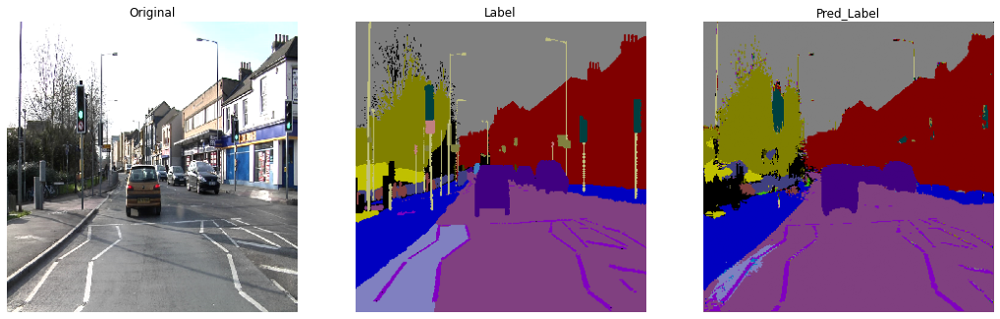


Epoch 1: val_loss did not improve from 0.45127
23/23 [==============================] - 96s 4s/step - loss: 0.3112 - accuracy: 0.8579 - val_loss: 0.4673 - val_accuracy: 0.8918 - lr: 1.0000e-05
Epoch 2/20
1/1 [==============================] - 0s 37ms/step


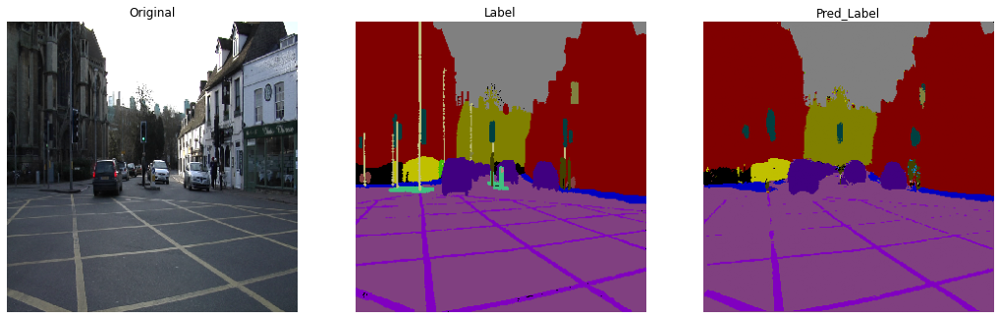


Epoch 2: val_loss did not improve from 0.45127
23/23 [==============================] - 101s 5s/step - loss: 0.3089 - accuracy: 0.8590 - val_loss: 0.4640 - val_accuracy: 0.8922 - lr: 1.0000e-05
Epoch 3/20
1/1 [==============================] - 0s 25ms/step


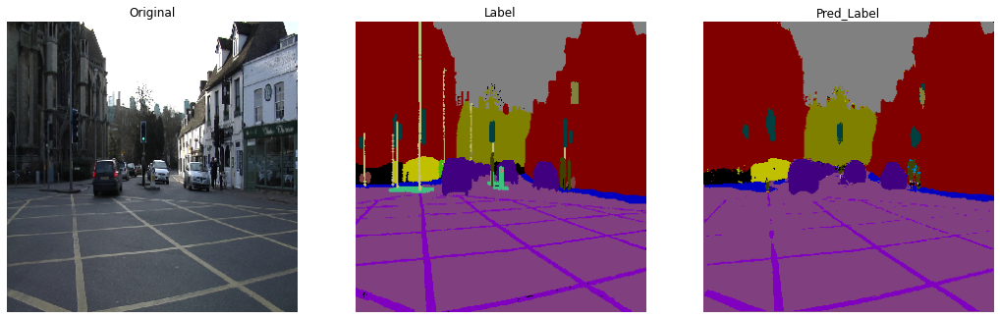


Epoch 3: val_loss did not improve from 0.45127
23/23 [==============================] - 92s 4s/step - loss: 0.3238 - accuracy: 0.8566 - val_loss: 0.4668 - val_accuracy: 0.8928 - lr: 1.0000e-05
Epoch 4/20
1/1 [==============================] - 0s 24ms/step


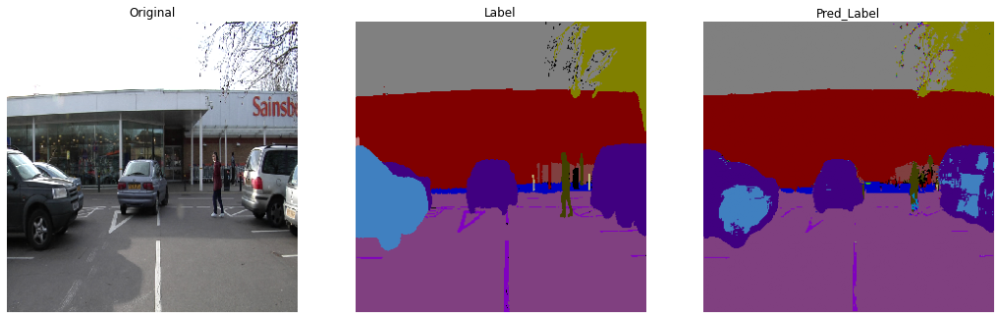


Epoch 4: val_loss improved from 0.45127 to 0.43851, saving model to Camvid-Weights1.hdf5
23/23 [==============================] - 100s 4s/step - loss: 0.3047 - accuracy: 0.8591 - val_loss: 0.4385 - val_accuracy: 0.8970 - lr: 1.0000e-05
Epoch 5/20
1/1 [==============================] - 0s 24ms/step


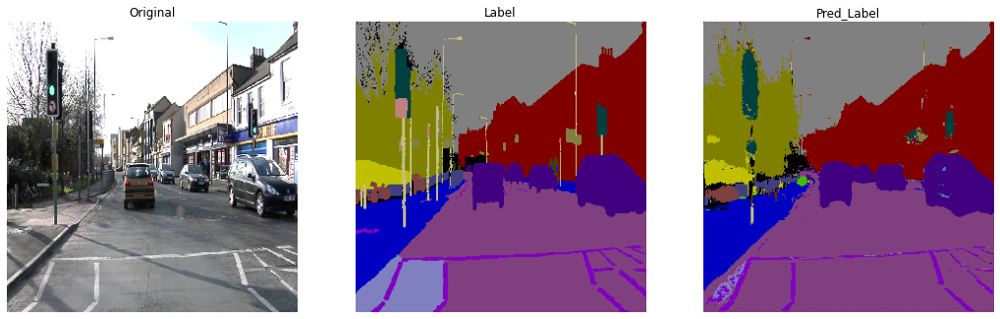


Epoch 5: val_loss did not improve from 0.43851
23/23 [==============================] - 98s 4s/step - loss: 0.3162 - accuracy: 0.8566 - val_loss: 0.4710 - val_accuracy: 0.8918 - lr: 1.0000e-05
Epoch 6/20
1/1 [==============================] - 0s 25ms/step


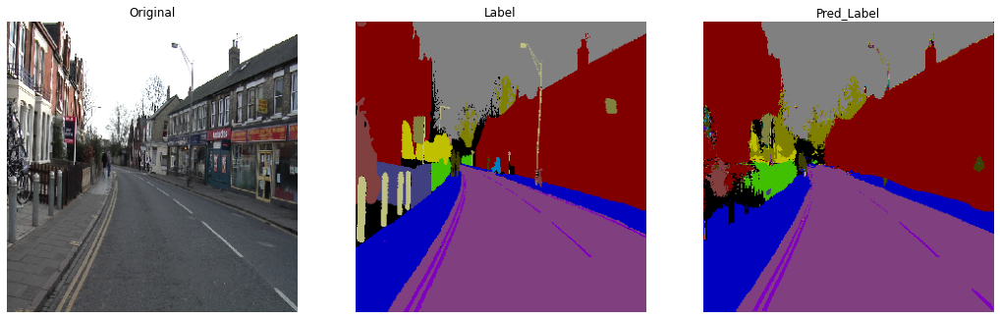


Epoch 6: val_loss did not improve from 0.43851
23/23 [==============================] - 94s 4s/step - loss: 0.3132 - accuracy: 0.8596 - val_loss: 0.4740 - val_accuracy: 0.8892 - lr: 1.0000e-05
Epoch 7/20
1/1 [==============================] - 0s 25ms/step


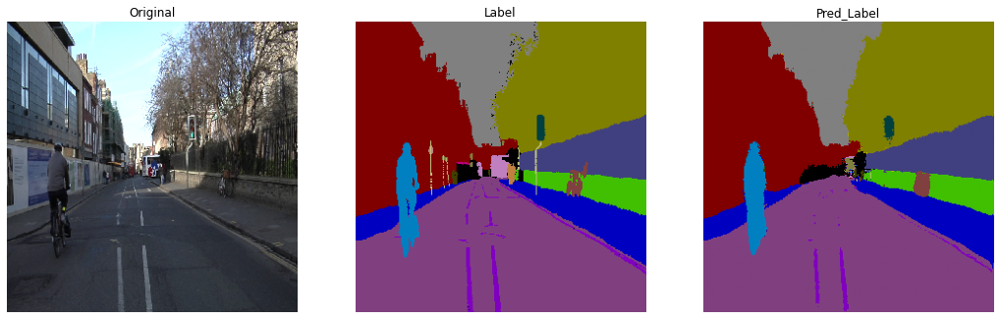


Epoch 7: val_loss did not improve from 0.43851
23/23 [==============================] - 98s 4s/step - loss: 0.3057 - accuracy: 0.8598 - val_loss: 0.4745 - val_accuracy: 0.8895 - lr: 1.0000e-05
Epoch 8/20
1/1 [==============================] - 0s 24ms/step


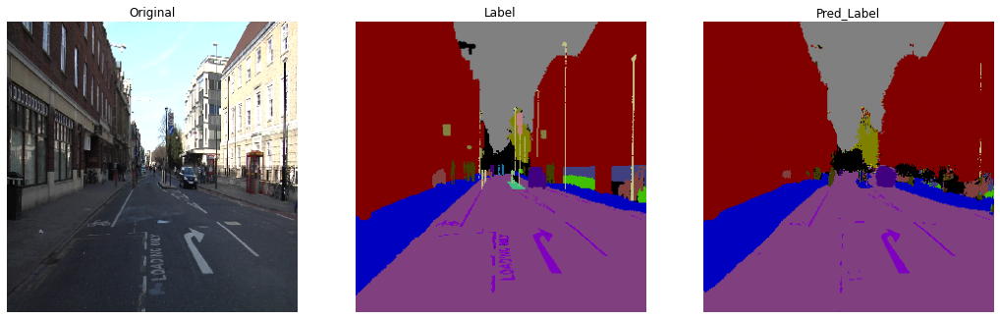


Epoch 8: val_loss did not improve from 0.43851
23/23 [==============================] - 94s 4s/step - loss: 0.3183 - accuracy: 0.8565 - val_loss: 0.4711 - val_accuracy: 0.8904 - lr: 1.0000e-05
Epoch 9/20
1/1 [==============================] - 0s 24ms/step


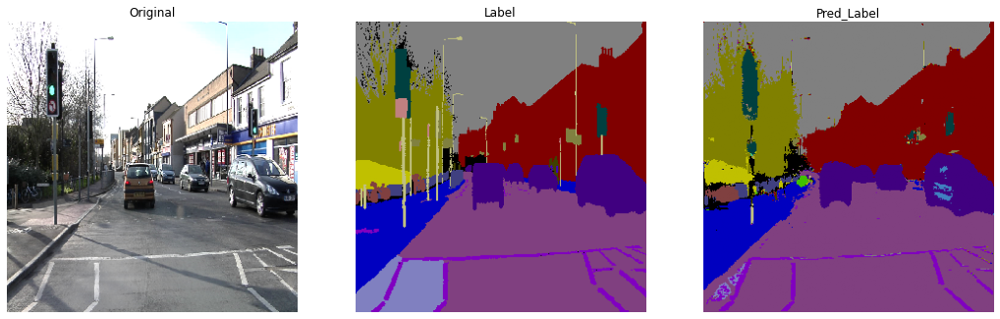


Epoch 9: val_loss did not improve from 0.43851
23/23 [==============================] - 97s 4s/step - loss: 0.3904 - accuracy: 0.8462 - val_loss: 0.4779 - val_accuracy: 0.8887 - lr: 1.0000e-05
Epoch 10/20
1/1 [==============================] - 0s 25ms/step


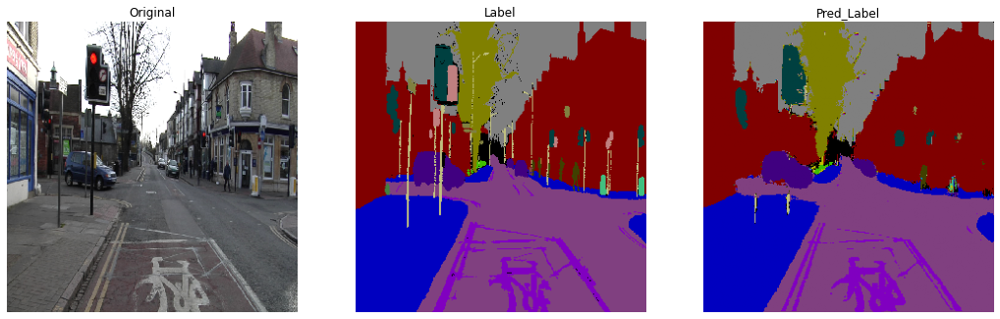


Epoch 10: val_loss did not improve from 0.43851
23/23 [==============================] - 94s 4s/step - loss: 0.3054 - accuracy: 0.8620 - val_loss: 0.4727 - val_accuracy: 0.8900 - lr: 1.0000e-05
Epoch 11/20
1/1 [==============================] - 0s 38ms/step


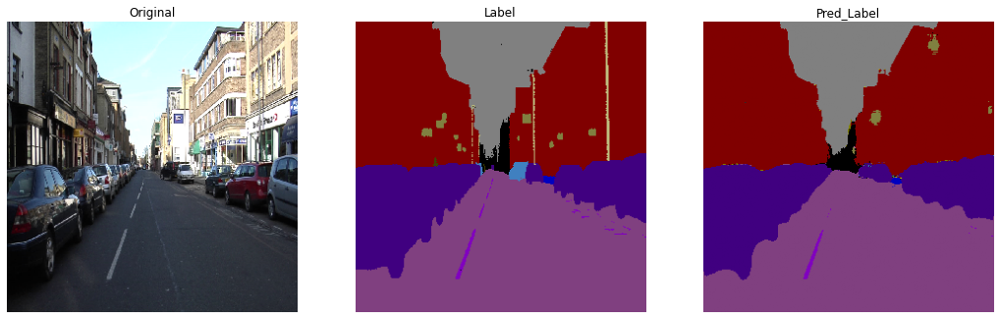


Epoch 11: val_loss did not improve from 0.43851
23/23 [==============================] - 93s 4s/step - loss: 0.3997 - accuracy: 0.8476 - val_loss: 0.4568 - val_accuracy: 0.8934 - lr: 1.0000e-05
Epoch 12/20
1/1 [==============================] - 0s 25ms/step


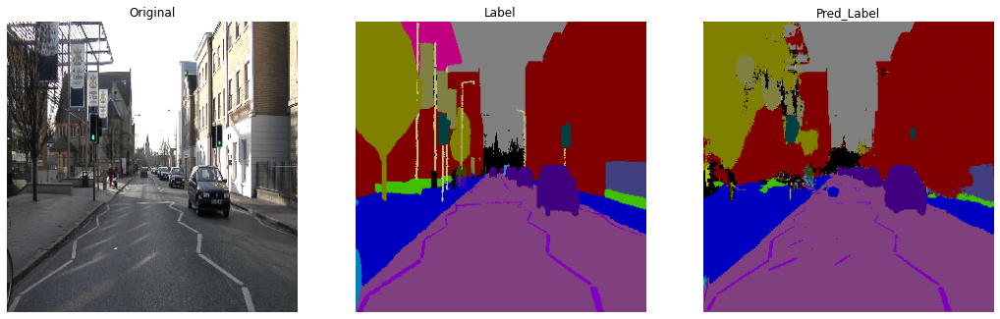


Epoch 12: val_loss did not improve from 0.43851
23/23 [==============================] - 98s 4s/step - loss: 0.3115 - accuracy: 0.8580 - val_loss: 0.4780 - val_accuracy: 0.8890 - lr: 1.0000e-05
Epoch 13/20
1/1 [==============================] - 0s 25ms/step


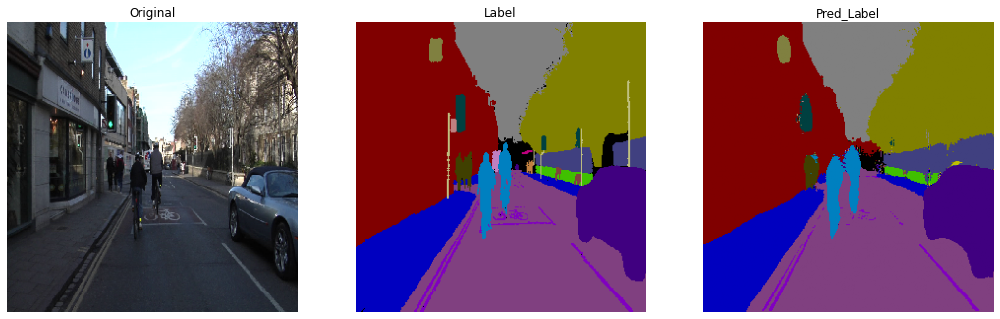


Epoch 13: val_loss did not improve from 0.43851
23/23 [==============================] - 92s 4s/step - loss: 0.3090 - accuracy: 0.8591 - val_loss: 0.4741 - val_accuracy: 0.8893 - lr: 1.0000e-06
Epoch 14/20
1/1 [==============================] - 0s 26ms/step


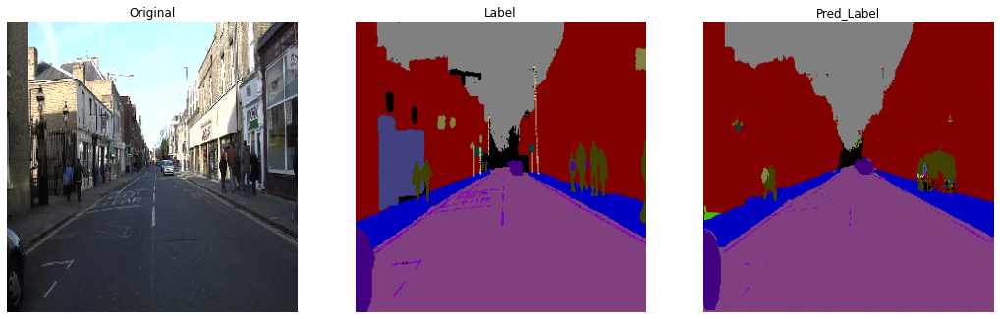


Epoch 14: val_loss did not improve from 0.43851
23/23 [==============================] - 96s 4s/step - loss: 0.3003 - accuracy: 0.8617 - val_loss: 0.4610 - val_accuracy: 0.8930 - lr: 1.0000e-06
Epoch 15/20
1/1 [==============================] - 0s 27ms/step


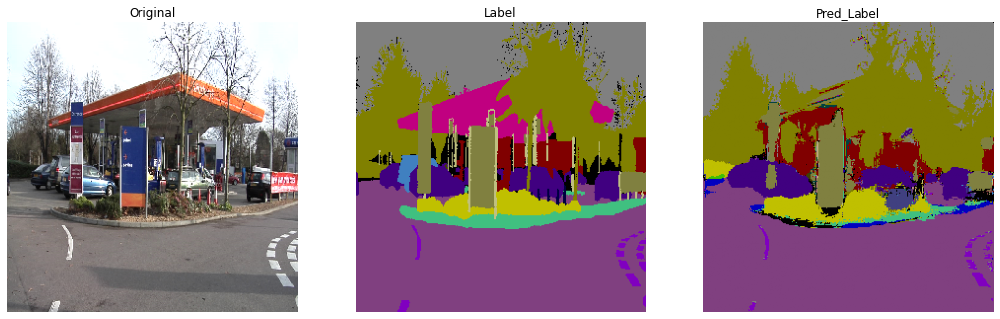


Epoch 15: val_loss did not improve from 0.43851
23/23 [==============================] - 97s 4s/step - loss: 0.3134 - accuracy: 0.8566 - val_loss: 0.4776 - val_accuracy: 0.8892 - lr: 1.0000e-06
Epoch 16/20
1/1 [==============================] - 0s 23ms/step


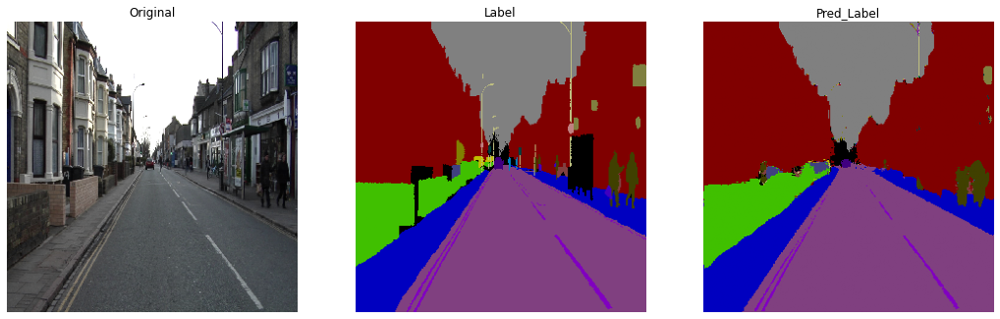


Epoch 16: val_loss did not improve from 0.43851
23/23 [==============================] - 99s 4s/step - loss: 0.3097 - accuracy: 0.8597 - val_loss: 0.4704 - val_accuracy: 0.8904 - lr: 1.0000e-06


In [ ]:
epochs=20
steps=int(369/B_size)
valid_steps=int(100/B_size)

Hisotry=model.fit(train_generator_fn(),
        validation_data=val_generator_fn(),
        steps_per_epoch=steps,
        validation_steps=valid_steps,
        epochs=epochs,
        callbacks=[Viz_process(),model_checkpoint,reduce_lr,Earlystop])

# 3.3 Evaluation & Predicting:

---



In [14]:
#for testing data:
image_datagen = ImageDataGenerator(rescale=1./255)
mask_datagen = ImageDataGenerator()
test_image_generator = image_datagen.flow_from_directory(
    data_path,
    class_mode=None,
    classes=['test'],
    seed=seed,
    batch_size=B_size,
    target_size=(Size,Size))

test_mask_generator = mask_datagen.flow_from_directory(
    data_path,
    classes=['test_labels'],
    class_mode=None,
    seed=seed,
    batch_size=B_size,
    color_mode='rgb',
    target_size=(Size,Size))

# combine generators into one which yields image and masks
test_generator = zip(test_image_generator, test_mask_generator)

def test_generator_fn():
    for (img,mask) in test_generator:
        new_mask = adjust_mask(mask)
        yield (img,new_mask)  

Found 232 images belonging to 1 classes.
Found 232 images belonging to 1 classes.


In [18]:
model.evaluate(test_generator_fn(),steps=len(test_image_generator))

15/15 [==============================] - 192s 13s/step - loss: 0.5552 - accuracy: 0.8673


[0.5551872253417969, 0.8673277497291565]

1/1 [==============================] - 0s 37ms/step


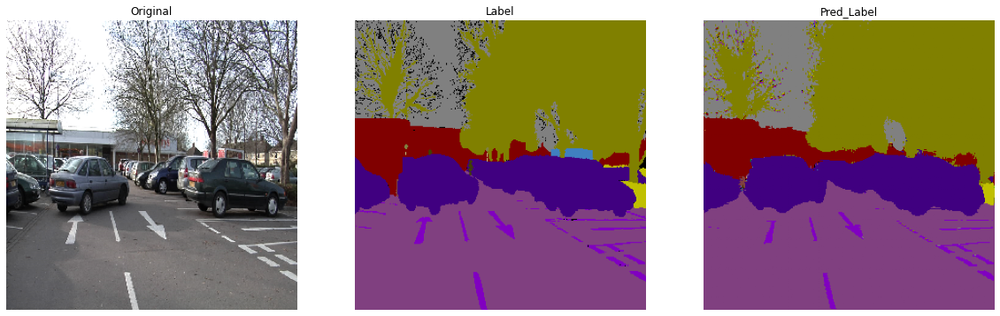

In [20]:
#predicting:
image_batch, label_batch = next(iter(test_generator))
idx=np.random.randint(image_batch.shape[0])
image,label=image_batch[idx],label_batch[idx]
label=label*1./255
# Get predicted label
pred_label = np.squeeze(model.predict(np.expand_dims(image, axis=0)),axis=0)
pred_label=np.argmax(pred_label,axis=-1)
rgb_mask = np.apply_along_axis(map_class_to_rgb, -1, np.expand_dims(pred_label,axis=-1))
rgb_mask=rgb_mask*1./255
### Display the image, true label, and predicted label
plt.figure(figsize=(20,9))
plt.subplot(131)
plt.imshow(image)
plt.axis('off')
plt.title('Original')
plt.subplot(132)
plt.imshow(label)
plt.axis('off')
plt.title('Label')   
plt.subplot(133)
plt.imshow(rgb_mask)
plt.axis('off')
plt.title('Pred_Label')
plt.show()